In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
# Root directory for dataset
dataroot = "CelebA_data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 50

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

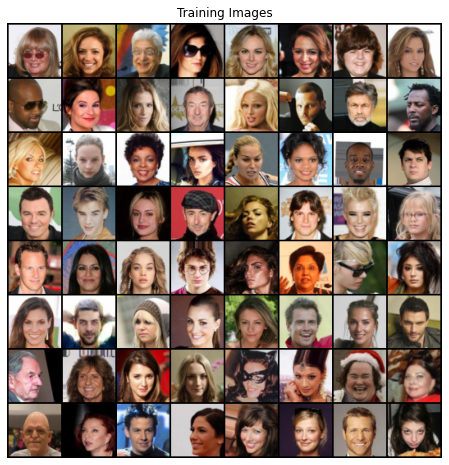

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
[0/50][0/1583]	Loss_D: 1.4717	Loss_G: 6.6494	D(x): 0.6884	D(G(z)): 0.5850 / 0.0024
[0/50][50/1583]	Loss_D: 0.5069	Loss_G: 17.0784	D(x): 0.9487	D(G(z)): 0.2676 / 0.0000
[0/50][100/1583]	Loss_D: 0.6864	Loss_G: 6.3101	D(x): 0.7393	D(G(z)): 0.0084 / 0.0114
[0/50][150/1583]	Loss_D: 0.5029	Loss_G: 4.0454	D(x): 0.9203	D(G(z)): 0.2909 / 0.0323
[0/50][200/1583]	Loss_D: 4.1844	Loss_G: 5.1185	D(x): 0.1241	D(G(z)): 0.0005 / 0.0196
[0/50][250/1583]	Loss_D: 0.4791	Loss_G: 4.0096	D(x): 0.7966	D(G(z)): 0.1392 / 0.0316
[0/50][300/1583]	Loss_D: 0.6557	Loss_G: 3.7866	D(x): 0.8226	D(G(z)): 0.3033 / 0.0433
[0/50][350/1583]	Loss_D: 0.7643	Loss_G: 3.7982	D(x): 0.7639	D(G(z)): 0.3083 / 0.0428
[0/50][400/1583]	Loss_D: 0.3847	Loss_G: 3.9354	D(x): 0.8116	D(G(z)): 0.1098 / 0.0346
[0/50][450/1583]	Loss_D: 0.4505	Loss_G: 3.9037	D(x): 0.7841	D(G(z)): 0.0936 / 0.0329
[0/50][500/1583]	Loss_D: 1.3588	Loss_G: 4.9454	D(x): 0.4284	D(G(z)): 0.0060 / 0.0289
[0/50][550/1583]	Loss_D: 0.8916	Loss_G: 7

[3/50][0/1583]	Loss_D: 0.6154	Loss_G: 1.7434	D(x): 0.6675	D(G(z)): 0.1524 / 0.2118
[3/50][50/1583]	Loss_D: 0.5605	Loss_G: 2.3067	D(x): 0.7864	D(G(z)): 0.2387 / 0.1253
[3/50][100/1583]	Loss_D: 1.7001	Loss_G: 6.4171	D(x): 0.8982	D(G(z)): 0.7342 / 0.0034
[3/50][150/1583]	Loss_D: 1.4339	Loss_G: 4.2899	D(x): 0.8957	D(G(z)): 0.6668 / 0.0189
[3/50][200/1583]	Loss_D: 0.6741	Loss_G: 2.3611	D(x): 0.6377	D(G(z)): 0.1262 / 0.1248
[3/50][250/1583]	Loss_D: 0.6587	Loss_G: 1.4739	D(x): 0.6492	D(G(z)): 0.1498 / 0.2637
[3/50][300/1583]	Loss_D: 0.8149	Loss_G: 4.0179	D(x): 0.8597	D(G(z)): 0.4356 / 0.0274
[3/50][350/1583]	Loss_D: 1.0194	Loss_G: 1.5250	D(x): 0.5134	D(G(z)): 0.1720 / 0.2604
[3/50][400/1583]	Loss_D: 0.7509	Loss_G: 3.3411	D(x): 0.8762	D(G(z)): 0.4225 / 0.0457
[3/50][450/1583]	Loss_D: 0.6144	Loss_G: 1.8291	D(x): 0.6362	D(G(z)): 0.0960 / 0.1944
[3/50][500/1583]	Loss_D: 1.0500	Loss_G: 1.0828	D(x): 0.4871	D(G(z)): 0.1234 / 0.4021
[3/50][550/1583]	Loss_D: 0.8535	Loss_G: 1.2443	D(x): 0.5333	D(G(z)):

[6/50][50/1583]	Loss_D: 1.3157	Loss_G: 5.7221	D(x): 0.9466	D(G(z)): 0.6141 / 0.0066
[6/50][100/1583]	Loss_D: 2.0485	Loss_G: 4.2792	D(x): 0.9700	D(G(z)): 0.7966 / 0.0237
[6/50][150/1583]	Loss_D: 0.5748	Loss_G: 4.0125	D(x): 0.9237	D(G(z)): 0.3450 / 0.0259
[6/50][200/1583]	Loss_D: 0.3786	Loss_G: 2.5145	D(x): 0.8346	D(G(z)): 0.1589 / 0.1008
[6/50][250/1583]	Loss_D: 0.8084	Loss_G: 1.6501	D(x): 0.5064	D(G(z)): 0.0363 / 0.2468
[6/50][300/1583]	Loss_D: 0.9112	Loss_G: 1.3409	D(x): 0.4858	D(G(z)): 0.0671 / 0.3175
[6/50][350/1583]	Loss_D: 0.5527	Loss_G: 2.2562	D(x): 0.8637	D(G(z)): 0.2996 / 0.1363
[6/50][400/1583]	Loss_D: 0.8837	Loss_G: 2.7644	D(x): 0.7991	D(G(z)): 0.4187 / 0.0815
[6/50][450/1583]	Loss_D: 0.4524	Loss_G: 2.6349	D(x): 0.6988	D(G(z)): 0.0432 / 0.0978
[6/50][500/1583]	Loss_D: 0.5890	Loss_G: 1.3302	D(x): 0.6628	D(G(z)): 0.0974 / 0.3219
[6/50][550/1583]	Loss_D: 0.7529	Loss_G: 5.0910	D(x): 0.9541	D(G(z)): 0.4506 / 0.0082
[6/50][600/1583]	Loss_D: 0.5130	Loss_G: 2.2452	D(x): 0.7484	D(G(z)

[9/50][100/1583]	Loss_D: 0.4529	Loss_G: 4.6112	D(x): 0.9572	D(G(z)): 0.2954 / 0.0160
[9/50][150/1583]	Loss_D: 0.8495	Loss_G: 1.6188	D(x): 0.5008	D(G(z)): 0.0113 / 0.2579
[9/50][200/1583]	Loss_D: 0.1971	Loss_G: 3.4152	D(x): 0.9274	D(G(z)): 0.1012 / 0.0445
[9/50][250/1583]	Loss_D: 1.0541	Loss_G: 2.2997	D(x): 0.6240	D(G(z)): 0.3218 / 0.1474
[9/50][300/1583]	Loss_D: 0.5188	Loss_G: 1.6712	D(x): 0.6740	D(G(z)): 0.0630 / 0.2442
[9/50][350/1583]	Loss_D: 0.2705	Loss_G: 3.2089	D(x): 0.8710	D(G(z)): 0.1071 / 0.0616
[9/50][400/1583]	Loss_D: 0.3402	Loss_G: 3.1100	D(x): 0.9103	D(G(z)): 0.1983 / 0.0617
[9/50][450/1583]	Loss_D: 0.5310	Loss_G: 1.5540	D(x): 0.6383	D(G(z)): 0.0269 / 0.2875
[9/50][500/1583]	Loss_D: 0.2300	Loss_G: 3.0628	D(x): 0.8821	D(G(z)): 0.0862 / 0.0655
[9/50][550/1583]	Loss_D: 0.5104	Loss_G: 3.7592	D(x): 0.9632	D(G(z)): 0.3338 / 0.0349
[9/50][600/1583]	Loss_D: 0.7638	Loss_G: 1.8033	D(x): 0.5623	D(G(z)): 0.0483 / 0.2514
[9/50][650/1583]	Loss_D: 0.4674	Loss_G: 2.6130	D(x): 0.6822	D(G(z

[12/50][100/1583]	Loss_D: 0.0969	Loss_G: 3.9164	D(x): 0.9425	D(G(z)): 0.0337 / 0.0299
[12/50][150/1583]	Loss_D: 0.1522	Loss_G: 4.3468	D(x): 0.9698	D(G(z)): 0.1020 / 0.0207
[12/50][200/1583]	Loss_D: 0.3517	Loss_G: 4.9739	D(x): 0.9589	D(G(z)): 0.2350 / 0.0108
[12/50][250/1583]	Loss_D: 0.1507	Loss_G: 3.3342	D(x): 0.8914	D(G(z)): 0.0245 / 0.0542
[12/50][300/1583]	Loss_D: 0.7409	Loss_G: 2.5171	D(x): 0.6694	D(G(z)): 0.1975 / 0.1362
[12/50][350/1583]	Loss_D: 1.8696	Loss_G: 6.9436	D(x): 0.9808	D(G(z)): 0.7230 / 0.0028
[12/50][400/1583]	Loss_D: 1.2544	Loss_G: 1.9323	D(x): 0.3682	D(G(z)): 0.0157 / 0.2079
[12/50][450/1583]	Loss_D: 0.1961	Loss_G: 3.6019	D(x): 0.9742	D(G(z)): 0.1441 / 0.0398
[12/50][500/1583]	Loss_D: 0.1202	Loss_G: 4.0610	D(x): 0.9439	D(G(z)): 0.0576 / 0.0255
[12/50][550/1583]	Loss_D: 0.1389	Loss_G: 3.1434	D(x): 0.8959	D(G(z)): 0.0224 / 0.0730
[12/50][600/1583]	Loss_D: 0.2715	Loss_G: 3.2085	D(x): 0.8820	D(G(z)): 0.1005 / 0.0611
[12/50][650/1583]	Loss_D: 0.1506	Loss_G: 3.9050	D(x): 

[15/50][50/1583]	Loss_D: 0.1290	Loss_G: 5.3921	D(x): 0.9849	D(G(z)): 0.0999 / 0.0074
[15/50][100/1583]	Loss_D: 0.0930	Loss_G: 3.9889	D(x): 0.9517	D(G(z)): 0.0390 / 0.0317
[15/50][150/1583]	Loss_D: 0.0424	Loss_G: 4.6411	D(x): 0.9749	D(G(z)): 0.0162 / 0.0159
[15/50][200/1583]	Loss_D: 0.7281	Loss_G: 1.1860	D(x): 0.6706	D(G(z)): 0.2097 / 0.3700
[15/50][250/1583]	Loss_D: 0.9662	Loss_G: 10.7024	D(x): 0.9973	D(G(z)): 0.5316 / 0.0000
[15/50][300/1583]	Loss_D: 1.3844	Loss_G: 4.2187	D(x): 0.9538	D(G(z)): 0.6379 / 0.0330
[15/50][350/1583]	Loss_D: 0.8277	Loss_G: 2.2864	D(x): 0.5390	D(G(z)): 0.0789 / 0.1657
[15/50][400/1583]	Loss_D: 0.1515	Loss_G: 3.6103	D(x): 0.9229	D(G(z)): 0.0566 / 0.0423
[15/50][450/1583]	Loss_D: 0.1943	Loss_G: 4.3098	D(x): 0.8955	D(G(z)): 0.0707 / 0.0221
[15/50][500/1583]	Loss_D: 0.1679	Loss_G: 4.1586	D(x): 0.9381	D(G(z)): 0.0797 / 0.0282
[15/50][550/1583]	Loss_D: 1.0527	Loss_G: 3.5969	D(x): 0.9000	D(G(z)): 0.5498 / 0.0403
[15/50][600/1583]	Loss_D: 0.1165	Loss_G: 4.4395	D(x): 

[18/50][0/1583]	Loss_D: 0.0985	Loss_G: 3.9645	D(x): 0.9189	D(G(z)): 0.0105 / 0.0352
[18/50][50/1583]	Loss_D: 0.0645	Loss_G: 5.1331	D(x): 0.9828	D(G(z)): 0.0408 / 0.0120
[18/50][100/1583]	Loss_D: 1.8921	Loss_G: 9.2121	D(x): 0.9995	D(G(z)): 0.7584 / 0.0003
[18/50][150/1583]	Loss_D: 1.1947	Loss_G: 0.6687	D(x): 0.4128	D(G(z)): 0.0644 / 0.5872
[18/50][200/1583]	Loss_D: 0.6727	Loss_G: 2.2537	D(x): 0.7443	D(G(z)): 0.2423 / 0.1698
[18/50][250/1583]	Loss_D: 0.2510	Loss_G: 4.4667	D(x): 0.9079	D(G(z)): 0.1114 / 0.0228
[18/50][300/1583]	Loss_D: 0.1467	Loss_G: 4.4283	D(x): 0.9525	D(G(z)): 0.0822 / 0.0208
[18/50][350/1583]	Loss_D: 0.0729	Loss_G: 4.5859	D(x): 0.9838	D(G(z)): 0.0528 / 0.0172
[18/50][400/1583]	Loss_D: 0.0621	Loss_G: 4.8942	D(x): 0.9719	D(G(z)): 0.0306 / 0.0146
[18/50][450/1583]	Loss_D: 0.0893	Loss_G: 4.3471	D(x): 0.9496	D(G(z)): 0.0276 / 0.0244
[18/50][500/1583]	Loss_D: 2.5575	Loss_G: 0.3914	D(x): 0.1384	D(G(z)): 0.0047 / 0.7113
[18/50][550/1583]	Loss_D: 0.1076	Loss_G: 4.9337	D(x): 0.9

[20/50][1550/1583]	Loss_D: 0.1070	Loss_G: 4.6517	D(x): 0.9188	D(G(z)): 0.0152 / 0.0255
[21/50][0/1583]	Loss_D: 0.1397	Loss_G: 6.0872	D(x): 0.9965	D(G(z)): 0.1121 / 0.0037
[21/50][50/1583]	Loss_D: 0.0598	Loss_G: 4.2900	D(x): 0.9804	D(G(z)): 0.0370 / 0.0268
[21/50][100/1583]	Loss_D: 0.0619	Loss_G: 4.5585	D(x): 0.9779	D(G(z)): 0.0371 / 0.0182
[21/50][150/1583]	Loss_D: 0.0555	Loss_G: 4.9657	D(x): 0.9823	D(G(z)): 0.0344 / 0.0132
[21/50][200/1583]	Loss_D: 0.0526	Loss_G: 4.8791	D(x): 0.9700	D(G(z)): 0.0201 / 0.0132
[21/50][250/1583]	Loss_D: 0.0457	Loss_G: 4.7177	D(x): 0.9819	D(G(z)): 0.0253 / 0.0146
[21/50][300/1583]	Loss_D: 0.4107	Loss_G: 8.2463	D(x): 0.9891	D(G(z)): 0.2763 / 0.0007
[21/50][350/1583]	Loss_D: 0.1592	Loss_G: 5.2592	D(x): 0.9875	D(G(z)): 0.1142 / 0.0090
[21/50][400/1583]	Loss_D: 0.8478	Loss_G: 3.4342	D(x): 0.8243	D(G(z)): 0.3901 / 0.0612
[21/50][450/1583]	Loss_D: 1.5738	Loss_G: 5.5494	D(x): 0.9872	D(G(z)): 0.6919 / 0.0129
[21/50][500/1583]	Loss_D: 0.1328	Loss_G: 4.5734	D(x): 0.

[23/50][1500/1583]	Loss_D: 0.0516	Loss_G: 4.9461	D(x): 0.9686	D(G(z)): 0.0171 / 0.0155
[23/50][1550/1583]	Loss_D: 0.0690	Loss_G: 5.5290	D(x): 0.9900	D(G(z)): 0.0538 / 0.0076
[24/50][0/1583]	Loss_D: 0.0532	Loss_G: 6.0808	D(x): 0.9883	D(G(z)): 0.0386 / 0.0044
[24/50][50/1583]	Loss_D: 0.0314	Loss_G: 5.8822	D(x): 0.9904	D(G(z)): 0.0192 / 0.0061
[24/50][100/1583]	Loss_D: 0.0417	Loss_G: 5.7274	D(x): 0.9663	D(G(z)): 0.0058 / 0.0083
[24/50][150/1583]	Loss_D: 0.0578	Loss_G: 5.0343	D(x): 0.9749	D(G(z)): 0.0306 / 0.0121
[24/50][200/1583]	Loss_D: 0.0414	Loss_G: 4.8993	D(x): 0.9791	D(G(z)): 0.0191 / 0.0148
[24/50][250/1583]	Loss_D: 0.0322	Loss_G: 5.9627	D(x): 0.9960	D(G(z)): 0.0270 / 0.0054
[24/50][300/1583]	Loss_D: 0.0220	Loss_G: 5.9032	D(x): 0.9911	D(G(z)): 0.0125 / 0.0078
[24/50][350/1583]	Loss_D: 0.8638	Loss_G: 3.7949	D(x): 0.9178	D(G(z)): 0.4621 / 0.0507
[24/50][400/1583]	Loss_D: 0.7090	Loss_G: 4.3670	D(x): 0.8644	D(G(z)): 0.3222 / 0.0440
[24/50][450/1583]	Loss_D: 0.1766	Loss_G: 4.0701	D(x): 0

[26/50][1450/1583]	Loss_D: 0.0421	Loss_G: 5.3033	D(x): 0.9947	D(G(z)): 0.0352 / 0.0080
[26/50][1500/1583]	Loss_D: 0.1530	Loss_G: 3.8087	D(x): 0.9028	D(G(z)): 0.0372 / 0.0442
[26/50][1550/1583]	Loss_D: 0.1020	Loss_G: 4.5642	D(x): 0.9462	D(G(z)): 0.0383 / 0.0247
[27/50][0/1583]	Loss_D: 0.0357	Loss_G: 5.6486	D(x): 0.9757	D(G(z)): 0.0099 / 0.0103
[27/50][50/1583]	Loss_D: 0.1830	Loss_G: 6.1183	D(x): 0.9642	D(G(z)): 0.1187 / 0.0046
[27/50][100/1583]	Loss_D: 0.5446	Loss_G: 3.5221	D(x): 0.6742	D(G(z)): 0.0113 / 0.0752
[27/50][150/1583]	Loss_D: 0.0917	Loss_G: 5.4403	D(x): 0.9427	D(G(z)): 0.0262 / 0.0122
[27/50][200/1583]	Loss_D: 0.0528	Loss_G: 5.5068	D(x): 0.9821	D(G(z)): 0.0319 / 0.0102
[27/50][250/1583]	Loss_D: 0.0932	Loss_G: 6.3421	D(x): 0.9878	D(G(z)): 0.0697 / 0.0043
[27/50][300/1583]	Loss_D: 0.0580	Loss_G: 4.9781	D(x): 0.9725	D(G(z)): 0.0218 / 0.0136
[27/50][350/1583]	Loss_D: 0.0769	Loss_G: 5.3693	D(x): 0.9584	D(G(z)): 0.0300 / 0.0120
[27/50][400/1583]	Loss_D: 0.5375	Loss_G: 1.8959	D(x): 

[29/50][1400/1583]	Loss_D: 0.0830	Loss_G: 5.7766	D(x): 0.9731	D(G(z)): 0.0468 / 0.0091
[29/50][1450/1583]	Loss_D: 0.0707	Loss_G: 5.0537	D(x): 0.9720	D(G(z)): 0.0302 / 0.0158
[29/50][1500/1583]	Loss_D: 0.1050	Loss_G: 3.6747	D(x): 0.9284	D(G(z)): 0.0240 / 0.0501
[29/50][1550/1583]	Loss_D: 0.3297	Loss_G: 3.3528	D(x): 0.8511	D(G(z)): 0.1161 / 0.0684
[30/50][0/1583]	Loss_D: 0.2269	Loss_G: 3.4496	D(x): 0.8247	D(G(z)): 0.0018 / 0.0792
[30/50][50/1583]	Loss_D: 0.0683	Loss_G: 5.2513	D(x): 0.9548	D(G(z)): 0.0114 / 0.0140
[30/50][100/1583]	Loss_D: 0.5544	Loss_G: 3.7813	D(x): 0.8757	D(G(z)): 0.2758 / 0.0383
[30/50][150/1583]	Loss_D: 1.1752	Loss_G: 1.4753	D(x): 0.4428	D(G(z)): 0.0852 / 0.3596
[30/50][200/1583]	Loss_D: 0.3920	Loss_G: 3.8206	D(x): 0.8277	D(G(z)): 0.1328 / 0.0477
[30/50][250/1583]	Loss_D: 0.1997	Loss_G: 6.4232	D(x): 0.9901	D(G(z)): 0.1553 / 0.0030
[30/50][300/1583]	Loss_D: 0.1101	Loss_G: 5.4467	D(x): 0.9855	D(G(z)): 0.0767 / 0.0096
[30/50][350/1583]	Loss_D: 0.7611	Loss_G: 3.4252	D(x):

[32/50][1350/1583]	Loss_D: 0.0504	Loss_G: 5.6746	D(x): 0.9943	D(G(z)): 0.0416 / 0.0067
[32/50][1400/1583]	Loss_D: 0.0384	Loss_G: 5.9362	D(x): 0.9782	D(G(z)): 0.0153 / 0.0091
[32/50][1450/1583]	Loss_D: 0.1387	Loss_G: 4.0640	D(x): 0.9311	D(G(z)): 0.0537 / 0.0354
[32/50][1500/1583]	Loss_D: 0.0261	Loss_G: 5.7887	D(x): 0.9972	D(G(z)): 0.0218 / 0.0080
[32/50][1550/1583]	Loss_D: 0.0501	Loss_G: 5.1098	D(x): 0.9750	D(G(z)): 0.0217 / 0.0159
[33/50][0/1583]	Loss_D: 0.0347	Loss_G: 6.2386	D(x): 0.9929	D(G(z)): 0.0253 / 0.0048
[33/50][50/1583]	Loss_D: 0.0367	Loss_G: 5.5759	D(x): 0.9833	D(G(z)): 0.0186 / 0.0085
[33/50][100/1583]	Loss_D: 0.0533	Loss_G: 4.6126	D(x): 0.9644	D(G(z)): 0.0144 / 0.0227
[33/50][150/1583]	Loss_D: 0.1349	Loss_G: 9.3818	D(x): 0.9973	D(G(z)): 0.1127 / 0.0002
[33/50][200/1583]	Loss_D: 0.0563	Loss_G: 5.2579	D(x): 0.9765	D(G(z)): 0.0235 / 0.0113
[33/50][250/1583]	Loss_D: 0.0396	Loss_G: 6.3801	D(x): 0.9919	D(G(z)): 0.0297 / 0.0043
[33/50][300/1583]	Loss_D: 0.4739	Loss_G: 1.9771	D(x)

[35/50][1300/1583]	Loss_D: 0.6750	Loss_G: 11.3279	D(x): 0.9991	D(G(z)): 0.3881 / 0.0000
[35/50][1350/1583]	Loss_D: 0.1068	Loss_G: 7.0262	D(x): 0.9853	D(G(z)): 0.0781 / 0.0023
[35/50][1400/1583]	Loss_D: 0.1894	Loss_G: 4.3723	D(x): 0.9078	D(G(z)): 0.0705 / 0.0339
[35/50][1450/1583]	Loss_D: 0.0771	Loss_G: 5.1960	D(x): 0.9716	D(G(z)): 0.0420 / 0.0161
[35/50][1500/1583]	Loss_D: 0.4337	Loss_G: 3.3868	D(x): 0.8299	D(G(z)): 0.1426 / 0.0653
[35/50][1550/1583]	Loss_D: 0.0612	Loss_G: 5.2325	D(x): 0.9759	D(G(z)): 0.0279 / 0.0122
[36/50][0/1583]	Loss_D: 0.4306	Loss_G: 11.3176	D(x): 0.9993	D(G(z)): 0.2908 / 0.0000
[36/50][50/1583]	Loss_D: 0.2708	Loss_G: 3.6231	D(x): 0.8766	D(G(z)): 0.0896 / 0.0662
[36/50][100/1583]	Loss_D: 0.0802	Loss_G: 4.7301	D(x): 0.9782	D(G(z)): 0.0520 / 0.0170
[36/50][150/1583]	Loss_D: 0.0395	Loss_G: 4.8201	D(x): 0.9761	D(G(z)): 0.0142 / 0.0185
[36/50][200/1583]	Loss_D: 0.0487	Loss_G: 5.4022	D(x): 0.9698	D(G(z)): 0.0156 / 0.0122
[36/50][250/1583]	Loss_D: 0.0539	Loss_G: 5.3854	D

[38/50][1250/1583]	Loss_D: 0.0414	Loss_G: 5.5839	D(x): 0.9857	D(G(z)): 0.0249 / 0.0100
[38/50][1300/1583]	Loss_D: 0.0311	Loss_G: 5.5885	D(x): 0.9830	D(G(z)): 0.0122 / 0.0116
[38/50][1350/1583]	Loss_D: 0.1766	Loss_G: 5.2172	D(x): 0.9672	D(G(z)): 0.1163 / 0.0102
[38/50][1400/1583]	Loss_D: 0.2496	Loss_G: 4.1792	D(x): 0.8271	D(G(z)): 0.0033 / 0.0452
[38/50][1450/1583]	Loss_D: 0.0805	Loss_G: 6.7147	D(x): 0.9955	D(G(z)): 0.0605 / 0.0029
[38/50][1500/1583]	Loss_D: 0.3547	Loss_G: 4.0882	D(x): 0.9472	D(G(z)): 0.2020 / 0.0342
[38/50][1550/1583]	Loss_D: 0.0342	Loss_G: 5.7223	D(x): 0.9878	D(G(z)): 0.0206 / 0.0106
[39/50][0/1583]	Loss_D: 2.1021	Loss_G: 13.7730	D(x): 0.9998	D(G(z)): 0.7459 / 0.0000
[39/50][50/1583]	Loss_D: 0.0267	Loss_G: 6.7443	D(x): 0.9839	D(G(z)): 0.0094 / 0.0040
[39/50][100/1583]	Loss_D: 0.2981	Loss_G: 3.2633	D(x): 0.9400	D(G(z)): 0.1631 / 0.0867
[39/50][150/1583]	Loss_D: 0.5325	Loss_G: 9.2929	D(x): 0.9958	D(G(z)): 0.3329 / 0.0004
[39/50][200/1583]	Loss_D: 0.5447	Loss_G: 2.0034	D

[41/50][1200/1583]	Loss_D: 0.5415	Loss_G: 3.0106	D(x): 0.7287	D(G(z)): 0.0879 / 0.1136
[41/50][1250/1583]	Loss_D: 0.0455	Loss_G: 5.3807	D(x): 0.9680	D(G(z)): 0.0105 / 0.0125
[41/50][1300/1583]	Loss_D: 0.3583	Loss_G: 4.6554	D(x): 0.9159	D(G(z)): 0.1684 / 0.0203
[41/50][1350/1583]	Loss_D: 0.2820	Loss_G: 4.1965	D(x): 0.8536	D(G(z)): 0.0628 / 0.0305
[41/50][1400/1583]	Loss_D: 0.0655	Loss_G: 6.4795	D(x): 0.9473	D(G(z)): 0.0023 / 0.0043
[41/50][1450/1583]	Loss_D: 0.1140	Loss_G: 4.9915	D(x): 0.9097	D(G(z)): 0.0009 / 0.0173
[41/50][1500/1583]	Loss_D: 0.2165	Loss_G: 5.0614	D(x): 0.9682	D(G(z)): 0.1407 / 0.0153
[41/50][1550/1583]	Loss_D: 0.0552	Loss_G: 5.0046	D(x): 0.9704	D(G(z)): 0.0174 / 0.0164
[42/50][0/1583]	Loss_D: 0.0330	Loss_G: 5.6893	D(x): 0.9876	D(G(z)): 0.0178 / 0.0089
[42/50][50/1583]	Loss_D: 0.0312	Loss_G: 6.9687	D(x): 0.9734	D(G(z)): 0.0031 / 0.0029
[42/50][100/1583]	Loss_D: 0.3496	Loss_G: 3.3379	D(x): 0.7754	D(G(z)): 0.0284 / 0.0801
[42/50][150/1583]	Loss_D: 0.0545	Loss_G: 5.6927	D

[44/50][1150/1583]	Loss_D: 0.1072	Loss_G: 6.0202	D(x): 0.9670	D(G(z)): 0.0566 / 0.0065
[44/50][1200/1583]	Loss_D: 0.2355	Loss_G: 5.1631	D(x): 0.9515	D(G(z)): 0.1314 / 0.0138
[44/50][1250/1583]	Loss_D: 0.0340	Loss_G: 5.9651	D(x): 0.9721	D(G(z)): 0.0036 / 0.0082
[44/50][1300/1583]	Loss_D: 0.0425	Loss_G: 5.6911	D(x): 0.9929	D(G(z)): 0.0328 / 0.0082
[44/50][1350/1583]	Loss_D: 0.0367	Loss_G: 5.4501	D(x): 0.9849	D(G(z)): 0.0204 / 0.0097
[44/50][1400/1583]	Loss_D: 0.0568	Loss_G: 5.4581	D(x): 0.9797	D(G(z)): 0.0315 / 0.0107
[44/50][1450/1583]	Loss_D: 0.1705	Loss_G: 4.3965	D(x): 0.9413	D(G(z)): 0.0860 / 0.0269
[44/50][1500/1583]	Loss_D: 0.0478	Loss_G: 5.1249	D(x): 0.9642	D(G(z)): 0.0088 / 0.0166
[44/50][1550/1583]	Loss_D: 0.1905	Loss_G: 4.6108	D(x): 0.9316	D(G(z)): 0.0960 / 0.0268
[45/50][0/1583]	Loss_D: 0.0286	Loss_G: 6.2839	D(x): 0.9949	D(G(z)): 0.0221 / 0.0057
[45/50][50/1583]	Loss_D: 0.1705	Loss_G: 4.8755	D(x): 0.9275	D(G(z)): 0.0641 / 0.0194
[45/50][100/1583]	Loss_D: 0.0482	Loss_G: 4.8729	

[47/50][1100/1583]	Loss_D: 0.0268	Loss_G: 5.7258	D(x): 0.9923	D(G(z)): 0.0183 / 0.0094
[47/50][1150/1583]	Loss_D: 0.1593	Loss_G: 5.8452	D(x): 0.9255	D(G(z)): 0.0512 / 0.0104
[47/50][1200/1583]	Loss_D: 0.0302	Loss_G: 5.8049	D(x): 0.9861	D(G(z)): 0.0152 / 0.0090
[47/50][1250/1583]	Loss_D: 0.0294	Loss_G: 7.7494	D(x): 0.9753	D(G(z)): 0.0035 / 0.0020
[47/50][1300/1583]	Loss_D: 5.5953	Loss_G: 1.8899	D(x): 0.0231	D(G(z)): 0.0019 / 0.3931
[47/50][1350/1583]	Loss_D: 0.1059	Loss_G: 6.2300	D(x): 0.9737	D(G(z)): 0.0667 / 0.0055
[47/50][1400/1583]	Loss_D: 0.4595	Loss_G: 4.2982	D(x): 0.8086	D(G(z)): 0.1162 / 0.0350
[47/50][1450/1583]	Loss_D: 0.0531	Loss_G: 5.6213	D(x): 0.9777	D(G(z)): 0.0270 / 0.0103
[47/50][1500/1583]	Loss_D: 0.0596	Loss_G: 5.2006	D(x): 0.9795	D(G(z)): 0.0349 / 0.0139
[47/50][1550/1583]	Loss_D: 0.3555	Loss_G: 3.9270	D(x): 0.9184	D(G(z)): 0.1766 / 0.0433
[48/50][0/1583]	Loss_D: 0.2042	Loss_G: 2.9674	D(x): 0.8498	D(G(z)): 0.0052 / 0.1292
[48/50][50/1583]	Loss_D: 0.0528	Loss_G: 7.0990

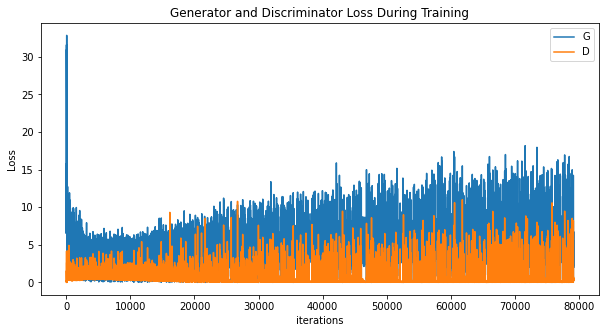

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21145707 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


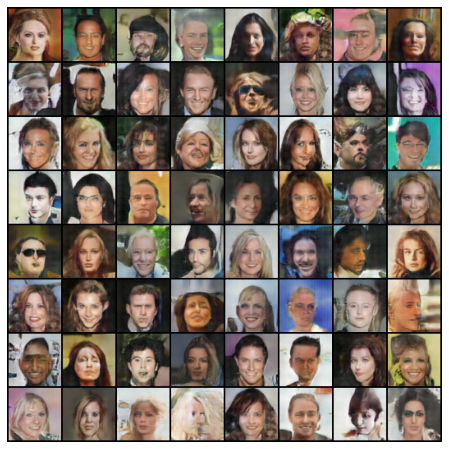

In [12]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

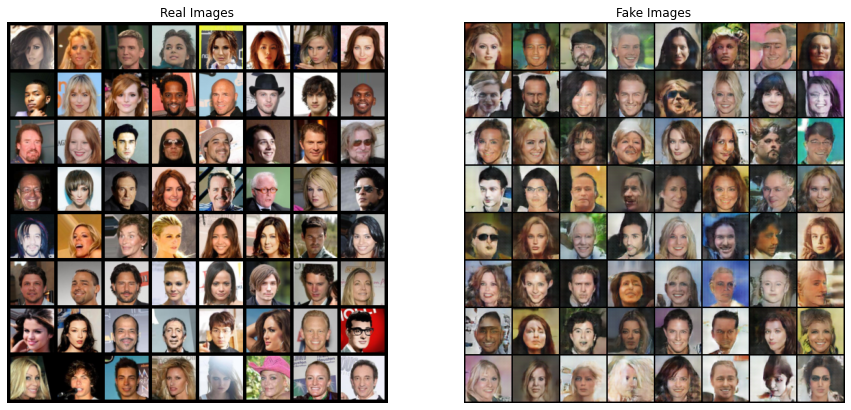

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [14]:
torch.save({
            'generator' : netG.state_dict(),
            'discriminator' : netD.state_dict(),
            'optimizerG' : optimizerG.state_dict(),
            'optimizerD' : optimizerD.state_dict(),
            }, './model_50final.pth')

In [15]:
ck = torch.load('./model_20final.pth')
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
    
netG.load_state_dict(ck['generator'])

<All keys matched successfully>

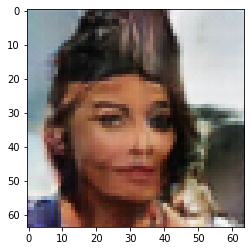

In [16]:
fixed_noise = torch.randn(1, nz, 1, 1, device=device)
plt.imshow((netG(fixed_noise).detach().cpu().numpy().squeeze().transpose(1, 2, 0) / 2 + 0.5))